# Training the neural network
Please only do this once you've run `main.py` and download the files and press the save button, as this relys on having the savestate avaliable

In [1]:
# Get savestate
from pickle import load
with open('cache/savestate.pkl', 'rb') as f:
    files = load(f)

files

{'Names':      Location    State                                   Name      Lat  \
 0       15590       NT                  ALICE SPRINGS AIRPORT -23.7951   
 1       14272       NT                      BATCHELOR AIRPORT -13.0544   
 2       14723       NT                     BORROLOOLA AIRPORT -16.0755   
 3       14954       NT                               BRADSHAW -14.9408   
 4       14808       NT  BRADSHAW - ANGALLARI VALLEY (DEFENCE) -15.4397   
 ..        ...      ...                                    ...      ...   
 645     92037  Unknown                 SWAN ISLAND LIGHTHOUSE -40.7300   
 646     94061  Unknown                     SANDFORD (MAYDENA) -42.9300   
 647     94063  Unknown                       SORELL (WHITLEA) -42.7900   
 648     95016  Unknown                               OSTERLEY -42.3400   
 649     99001  Unknown                            DEAL ISLAND -39.4800   
 
          Long  
 0    133.8890  
 1    131.0252  
 2    136.3041  
 3    130.8091  
 4  

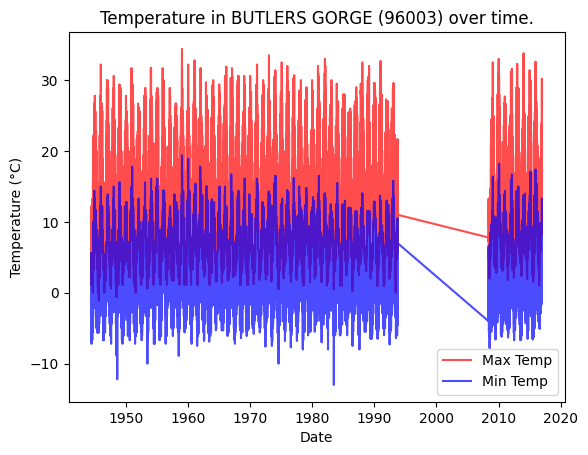

In [2]:
import matplotlib.pyplot as plt
from random import randint
while True:
    place = files['Names'].loc[randint(0, len(files['Names']))]
    if '0'*(6-len(str(place.Location)))+str(place.Location) in files['Temps']:
        break
# place = '27042'

tempdf = files['Temps']['0'*(6-len(str(place.Location)))+str(place.Location)]
plt.plot(tempdf['Date'], tempdf['MaxTemp'], label='Max Temp', color="red", alpha=0.7)
plt.plot(tempdf['Date'], tempdf['MinTemp'], label='Min Temp', color="blue", alpha=0.7)
plt.legend()
#plt.fill_between(df['Date'], df['MaxTemp'], df['MinTemp'], alpha=0.3)
plt.xlabel('Date')
plt.ylabel('Temperature (°C)')
plt.title(f'Temperature in {place.Name} ({place.Location}) over time.')
plt.show()
# PLEASE NOTE: If there is a gap, it is because there is no data for that time. This is not an error.

Borrowed code from https://github.com/mumarse/Sin_Wave_Prediction/blob/master/RNN-LSTM-SineWave.ipynb

,Temp
0,6.7
1,7.8
2,8.9
3,12.2
4,8.9
...,...
20866,18.7
20867,19.8
20868,19.7
20869,19.5


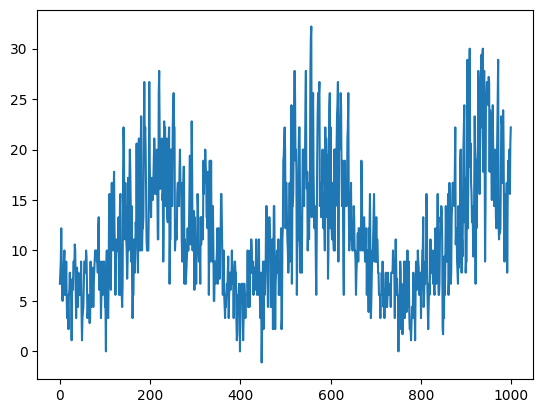

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
# Generate the sin wave
#x = np.linspace(0,50,501)
#y = np.sin(x)
# Turn it into a dataframe
#df = pd.DataFrame(data=y,columns=['Temp'])
df = pd.DataFrame(data=tempdf['MaxTemp'],columns=['Temp'])
# Plot it
plt.plot(df.iloc[:1000])
df

In [31]:
# Split training and testing data
# test_percent = 0.1
# test_ind = int(len(df) - np.round(len(df)*test_percent))
# train = df.iloc[:test_ind]
# test = df.iloc[test_ind:]
test_amount = 500
train_amount = 4000#len(df)-test_amount-1000
train = df.iloc[:train_amount]
test = df.iloc[-test_amount:]

# Scale data
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
scaled_full_data = scaler.fit_transform(train)
from tensorflow.keras.preprocessing.sequence import TimeseriesGenerator
# define generator
batch_size = 1 # Number of timeseries samples in each batch
length = 50 # Length of the output sequences (in number of timesteps)
generator = TimeseriesGenerator(scaled_full_data, scaled_full_data, length=length, batch_size=batch_size)
# What does the first batch look like?
X,y = generator[0]
print(f'Given the Array: \n{X.flatten()}')
print(f'Predict this y: \n {y}')

Given the Array: 
[0.23423423 0.26726727 0.3003003  0.3993994  0.3003003  0.2012012
 0.18318318 0.23423423 0.24924925 0.3003003  0.33333333 0.2012012
 0.26726727 0.2012012  0.3003003  0.2012012  0.13213213 0.2012012
 0.16516517 0.0990991  0.2012012  0.21621622 0.26726727 0.2012012
 0.23423423 0.2012012  0.06606607 0.23423423 0.24924925 0.21621622
 0.3003003  0.3003003  0.28228228 0.35135135 0.33333333 0.21621622
 0.13213213 0.23423423 0.28228228 0.18318318 0.16516517 0.26726727
 0.2012012  0.2012012  0.23423423 0.21621622 0.2012012  0.3003003
 0.15015015 0.06606607]
Predict this y: 
 [[0.13213213]]


In [16]:
# Create the model
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Dropout
n_features = 1
model = Sequential()
model.add(LSTM(length, return_sequences=True, input_shape=(length, n_features)))
model.add(Dropout(0.2))
model.add(LSTM(50))
model.add(Dropout(0.2))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')
model.fit(generator,epochs=6)

model.summary()

Epoch 1/6
3950/3950 [==============================] - 83s 20ms/step - loss: 0.0197
Epoch 2/6
3950/3950 [==============================] - 78s 20ms/step - loss: 0.0152
Epoch 3/6
3950/3950 [==============================] - 78s 20ms/step - loss: 0.0147
Epoch 4/6
3950/3950 [==============================] - 78s 20ms/step - loss: 0.0143
Epoch 5/6
3950/3950 [==============================] - 78s 20ms/step - loss: 0.0142
Epoch 6/6
3950/3950 [==============================] - 78s 20ms/step - loss: 0.0139
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_3 (LSTM)               (None, 50, 50)            10400     
                                                                 
 dropout_2 (Dropout)         (None, 50, 50)            0         
                                                                 
 lstm_4 (LSTM)               (None, 50)                20200     
            

<Axes: >

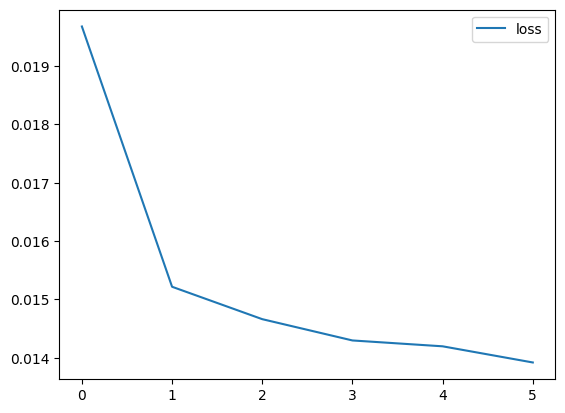

In [17]:
losses = pd.DataFrame(model.history.history)
losses.plot()

In [18]:
first_eval_batch = scaled_full_data[-length:]
first_eval_batch.reshape((1, length, n_features))

array([[[0.23423423],
        [0.24924925],
        [0.31531532],
        [0.33333333],
        [0.36636637],
        [0.24924925],
        [0.24924925],
        [0.06606607],
        [0.16516517],
        [0.2012012 ],
        [0.21621622],
        [0.21621622],
        [0.16516517],
        [0.11711712],
        [0.23423423],
        [0.26726727],
        [0.16516517],
        [0.15015015],
        [0.11711712],
        [0.23423423],
        [0.28228228],
        [0.2012012 ],
        [0.28228228],
        [0.36636637],
        [0.2012012 ],
        [0.28228228],
        [0.26726727],
        [0.33333333],
        [0.3003003 ],
        [0.31531532],
        [0.26726727],
        [0.28228228],
        [0.3003003 ],
        [0.33333333],
        [0.26726727],
        [0.24924925],
        [0.28228228],
        [0.45045045],
        [0.38438438],
        [0.23423423],
        [0.28228228],
        [0.35135135],
        [0.38438438],
        [0.23423423],
        [0.18318318],
        [0

In [33]:
forecast = []

first_eval_batch = scaled_full_data[-length:]
current_batch = first_eval_batch.reshape((1, length, n_features))

tot = len(test)

for i in range(tot):
    # get prediction 1 time stamp ahead ([0] is for grabbing just the number instead of [array])
    current_pred = model.predict(current_batch)[0]
    
    # store prediction
    forecast.append(current_pred) 
    
    # update batch to now include prediction and drop first value
    current_batch = np.append(current_batch[:,1:,:],[[current_pred]],axis=1)
    print(f'{i+1}/{tot}')
forecast = scaler.inverse_transform(forecast)

1/1 [==============================] - 0s 112ms/step
1/500
1/1 [==============================] - 0s 75ms/step
2/500
1/1 [==============================] - 0s 55ms/step
3/500
1/1 [==============================] - 0s 105ms/step
4/500
1/1 [==============================] - 0s 54ms/step
5/500
1/1 [==============================] - 0s 53ms/step
6/500
1/1 [==============================] - 0s 52ms/step
7/500
1/1 [==============================] - 0s 50ms/step
8/500
1/1 [==============================] - 0s 57ms/step
9/500
1/1 [==============================] - 0s 59ms/step
10/500
1/1 [==============================] - 0s 53ms/step
11/500
1/1 [==============================] - 0s 49ms/step
12/500
1/1 [==============================] - 0s 42ms/step
13/500
1/1 [==============================] - 0s 42ms/step
14/500
1/1 [==============================] - 0s 47ms/step
15/500
1/1 [==============================] - 0s 58ms/step
16/500
1/1 [==============================] - 0s 50ms/step
17/500
1/1 

In [34]:
forecast

array([[ 1.11885312e+01],
       [ 9.81215756e+00],
       [ 9.05025893e+00],
       [ 8.65259035e+00],
       [ 8.50630804e+00],
       [ 8.51326587e+00],
       [ 8.59051167e+00],
       [ 8.67680236e+00],
       [ 8.73667787e+00],
       [ 8.75770620e+00],
       [ 8.74374190e+00],
       [ 8.70641510e+00],
       [ 8.65830271e+00],
       [ 8.60905499e+00],
       [ 8.56408161e+00],
       [ 8.52491090e+00],
       [ 8.49076380e+00],
       [ 8.45989963e+00],
       [ 8.43034643e+00],
       [ 8.40064338e+00],
       [ 8.36984073e+00],
       [ 8.33771320e+00],
       [ 8.30455852e+00],
       [ 8.27060197e+00],
       [ 8.23610158e+00],
       [ 8.20152476e+00],
       [ 8.16685566e+00],
       [ 8.13213891e+00],
       [ 8.09727430e+00],
       [ 8.06227273e+00],
       [ 8.02707169e+00],
       [ 7.99168705e+00],
       [ 7.95606423e+00],
       [ 7.92017147e+00],
       [ 7.88398694e+00],
       [ 7.84760790e+00],
       [ 7.81103534e+00],
       [ 7.77421963e+00],
       [ 7.7

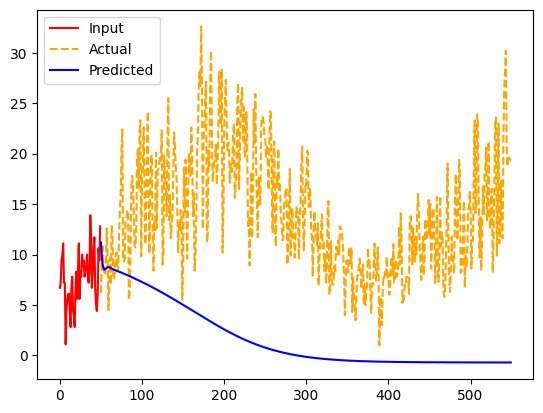

In [35]:
plt.plot(list(train[-length:]['Temp']), 'r-', label='Input')
x_axis = range(len(train[-length:]), len(train[-length:])+len(test))
plt.plot(x_axis, list(test['Temp']), '--', color='orange', label='Actual')
plt.plot(x_axis, forecast, 'b-', label='Predicted')
plt.legend()
plt.show()